In [1]:
import pickle
import matplotlib.pyplot as plt
import numpy as np 
from tqdm import tqdm

with open('attention_vis_with_time.pickle', 'rb') as handle:
    atten_vis = pickle.load(handle)

In [2]:
atten_vis['t1']

{2338: array([[7.19603795e+02, 2.19190000e+04],
        [1.19588671e+02, 1.68770000e+04],
        [1.00893666e+02, 3.91800000e+03],
        [3.53788963e+00, 5.62000000e+02],
        [3.18794661e+02, 7.88600000e+03],
        [8.05273746e+01, 3.12000000e+03],
        [5.52752171e+01, 1.12600000e+03],
        [2.57313910e+03, 7.58850000e+04],
        [3.26780032e+01, 9.59000000e+02],
        [2.45843211e+03, 7.66050000e+04],
        [8.28829710e+02, 2.18160000e+04],
        [9.28352262e+03, 1.50452000e+05],
        [6.23437671e+01, 2.25600000e+03],
        [6.67179403e+02, 3.03870000e+04],
        [1.75743913e+03, 5.92320000e+04],
        [1.98489250e+03, 5.81630000e+04],
        [1.93499405e+02, 5.95600000e+03],
        [7.06513799e+02, 2.54700000e+04],
        [3.77861191e+03, 1.31895000e+05],
        [7.69356894e+01, 2.09900000e+03],
        [2.14501668e+02, 5.16700000e+03],
        [1.22093778e+01, 6.02000000e+02],
        [1.41877047e+03, 2.67940000e+04],
        [7.41929342e+01, 1.7

In [3]:
with open('id2relation.pickle', 'rb') as handle:
    id2relation = pickle.load(handle)

In [4]:
def plot_attention(atten_vis, time_periods='t1'):
    num_rel = len(list(id2relation.keys()))
    atten_mat = np.zeros((num_rel, num_rel))
    for i in id2relation.keys():
        if i not in atten_vis[time_periods].keys():
            continue
        attn_at_i = atten_vis[time_periods][i][:, 0] / atten_vis[time_periods][i][:, 1]
        atten_mat[i, :] = attn_at_i.reshape(1, -1)
    atten_mat = np.nan_to_num(atten_mat, nan=0)
    plt.matshow(atten_mat)
    return atten_mat

/tmp/ipykernel_2509044/2584139434.py:7: RuntimeWarning: invalid value encountered in divide
  attn_at_i = atten_vis[time_periods][i][:, 0] / atten_vis[time_periods][i][:, 1]


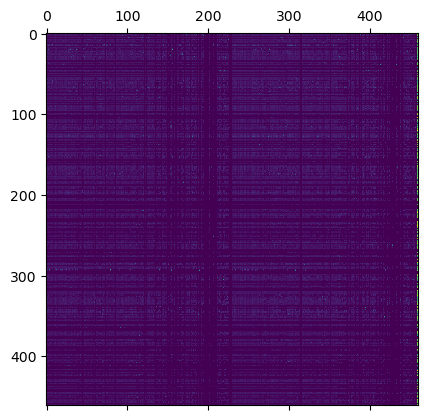

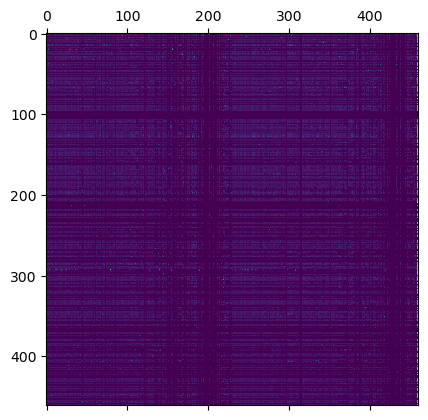

In [6]:
mat4vis_t1 = plot_attention(atten_vis, time_periods='t1')
mat4vis_t2 = plot_attention(atten_vis, time_periods='t2')

In [7]:
def save_fig(mat, filename):
    from matplotlib.font_manager import FontProperties
    import seaborn as sns

    font = FontProperties('sans')
    font.set_size(10)
    font_axis = {'family' : 'sans',
    'weight' : 'light',
    'size'  : 16,
    }

    font_axis2 = {'family' : 'Times New Roman',
    'weight' : 'light',
    'size'  : 22,
    }

    fig =plt.figure(dpi=400, figsize=(7,5))
    sns.heatmap(mat)

    x_pos = np.arange(0, 10, 1) + 0.5
    y_pos = np.arange(0, 10, 1) + 0.5

    labels = np.arange(1, 11, 1) + 0

    plt.xticks(x_pos, labels, rotation=0, fontproperties=font)
    plt.yticks(y_pos, labels, rotation=0, fontproperties=font)

    plt.xlabel('Relations in r-digraphs',font_axis)
    plt.ylabel('Query relations',font_axis)
    plt.title('ICEWS14 (ex)', font_axis2)
    plt.savefig(f"ICEWS14 (ex){filename}.pdf", bbox_inches='tight', pad_inches=0.02)
    plt.show()

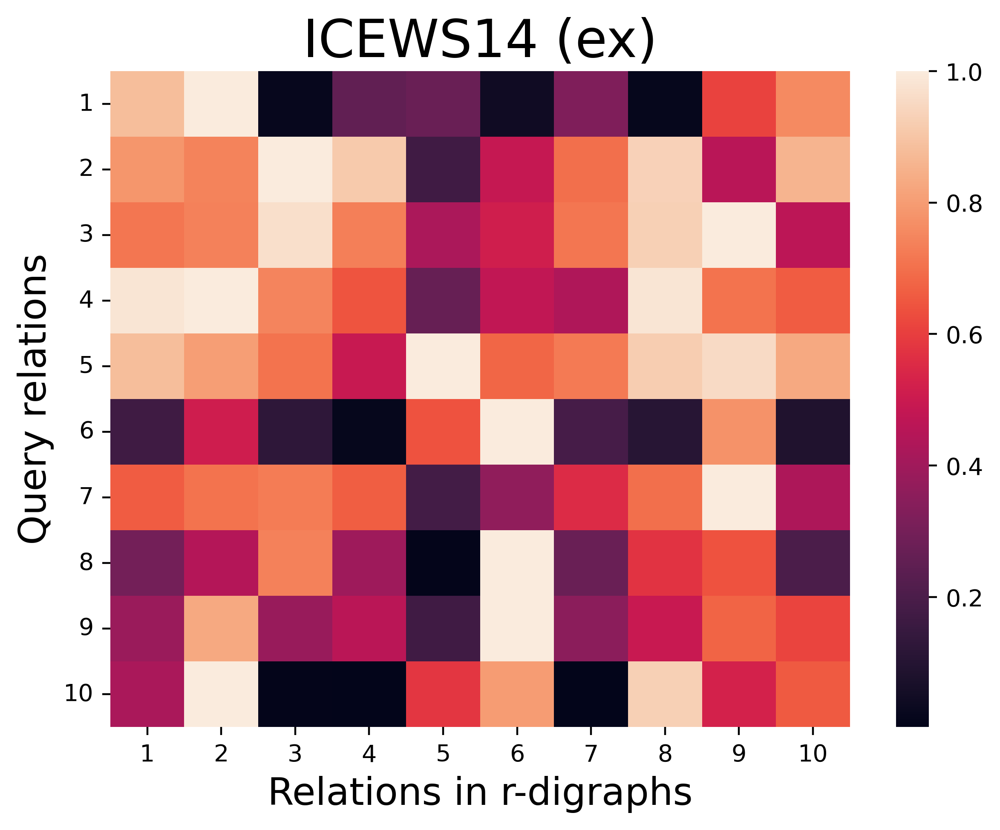

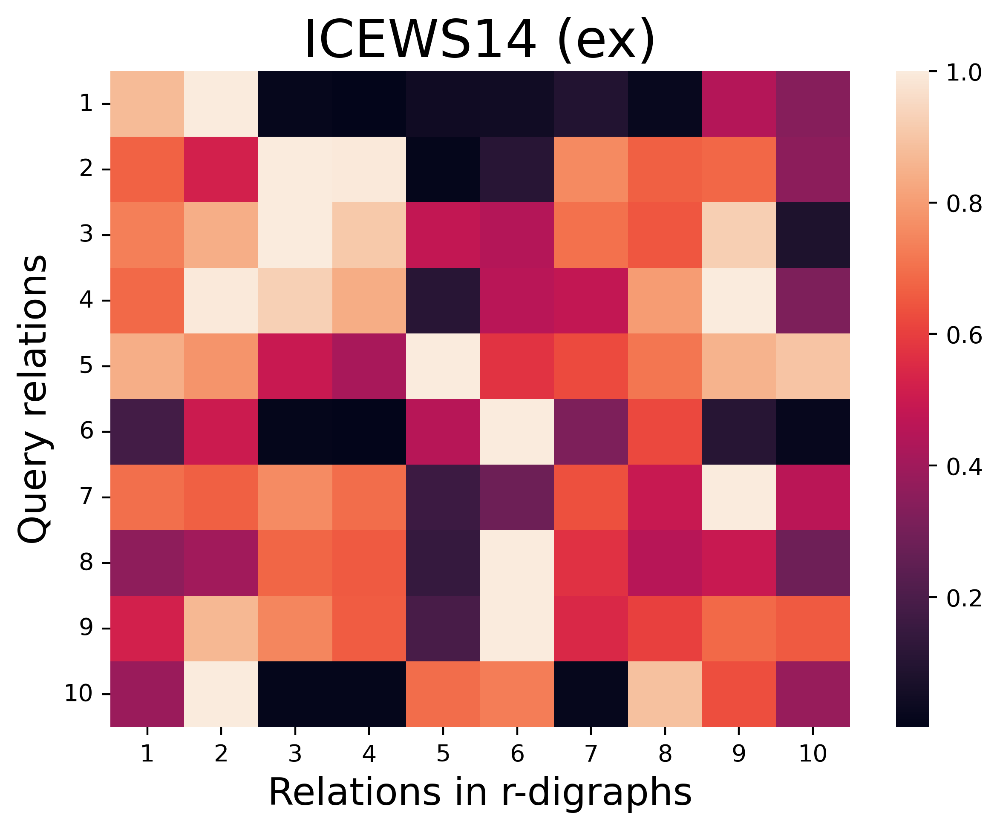

In [14]:

row_weight_t1 = mat4vis_t1.sum(axis=1)
row_weight_t1 = row_weight_t1 / row_weight_t1.sum()

row_weight_t1 = np.nan_to_num(row_weight_t1, nan=0)

col_index = np.random.choice(np.arange(mat4vis_t1.shape[0]), size=10, replace=False, p=row_weight_t1)

mat4vis_t1_filtered = mat4vis_t1[col_index, :][:, col_index]
mat4vis_t1_filtered = mat4vis_t1_filtered / mat4vis_t1_filtered.max(axis=1, keepdims=True)

mat4vis_t2_filtered = mat4vis_t2[col_index, :][:, col_index]
mat4vis_t2_filtered = mat4vis_t2_filtered / mat4vis_t2_filtered.max(axis=1, keepdims=True)

save_fig(mat4vis_t1_filtered, 't1')
save_fig(mat4vis_t2_filtered, 't2')



In [15]:
print(col_index)

[344 234 224 226  50  59 345 275  67 149]


In [ ]:
for idx, id_num in enumerate(col_index):
    print(f'#{idx+1}'id2relation[id_num])